In [1]:
using Plots
using DifferentialEquations
using LaTeXStrings
using Roots
using Graphs
using StatsBase
using GraphPlot
using GraphRecipes

# Lucas Schmidt Ferreira de Araujo

# Report 05

# Exercice I

The SIR model is described by the set of equations

$$ \frac{dS(t)}{dt} =  - \beta S(t)I(t)$$

$$ \frac{dI}{dt} = \beta S(t)I(t) - rI(t) $$

$$ \frac{dR}{dt} = rI(t) $$

Where 

$$ R_0 = \frac{\beta N}{r}$$

In [2]:
function SIR(dudt , u , Param , t)
    S,I,R = u
    β , r = Param
    dudt[1] = - β * S * I
    dudt[2] = β * S * I - r * I
    dudt[3] = r * I
end

function R0(β,N,r)
    return β * N / r
end

function solve_SIR(Param, u0, Tf, nit::Int)
    S = zeros(nit)
    I = zeros(nit)
    R = zeros(nit)
    t = range(0, Tf, length=nit)

    tspan = (0.0, Tf)
    prob = ODEProblem(SIR, u0, tspan, Param)
    sol = solve(prob, saveat=t)

    for q in 1:length(sol.u)
        S[q] = sol.u[q][1]
        I[q] = sol.u[q][2]
        R[q] = sol.u[q][3]
    end

    return S, I, R, t
end

solve_SIR (generic function with 1 method)

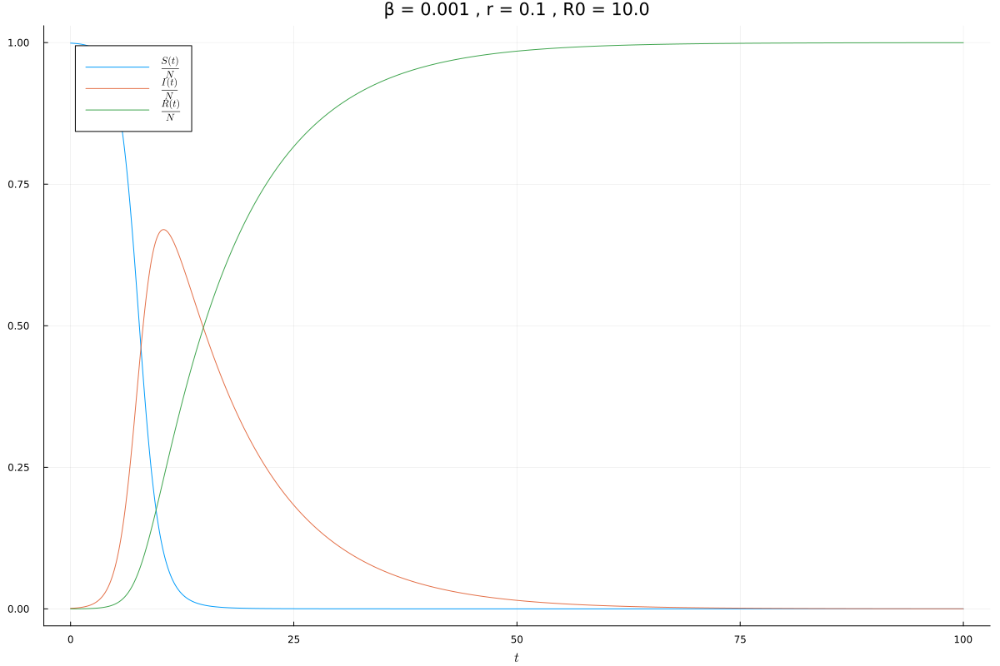

In [3]:
N = 1000
Tf = 100
Param = [1/N,.1]
tspan = (0.0, Tf)
u0 = [N-1,1,0]
prob = ODEProblem(SIR , u0 , tspan , Param)
sol = solve(prob,tstops=0.0:0.1:Tf)

S = [ q[1] for q in sol.u]
I = [ q[2] for q in sol.u]
R = [ q[3] for q in sol.u]
t = range(0,Tf , length(S))

plot(t , S ./ N , label = L"\frac{S(t)}{N}",size=(1200,800) )
plot!(t , I ./ N, label = L"\frac{I(t)}{N}")
plot!(t , R ./ N, label = L"\frac{R(t)}{N}")
xlabel!(L"t")
title!("β = $(1/N) , r = $(.1) , R0 = $(R0(1/N,N,.1))" , label =L"S(t)")

a) 

# Subcritical Case $R_0 < 1$

We have

$$ \beta N < r$$

In [5]:
N = 100
Tf = 1000.0
nit = 1000
tspan = (0.0, Tf)
ϵ = .0001

R_ = [.05,.1,.15,.2]
B = [q/N - ϵ for q in R_]
r0 = [R0(B[q],N,R_[q]) for q in 1:length(R_)] 

S = zeros(nit,length(R_))
I = zeros(nit,length(R_))
R = zeros(nit,length(R_))
t = range(0,Tf,nit)

for q in 1:length(R_)
    β = B[q]
    r = R_[q]
    Param = [β,r]
    u0 = [N-1,1,0]
    prob = ODEProblem(SIR , u0 , tspan , Param)
    sol = solve(prob,saveat=range(0,Tf,nit))
    for i in 1:length(sol.u)
        S[i,q] = sol.u[i][1]
        I[i,q] = sol.u[i][2]
        R[i,q] = sol.u[i][3]
    end
end

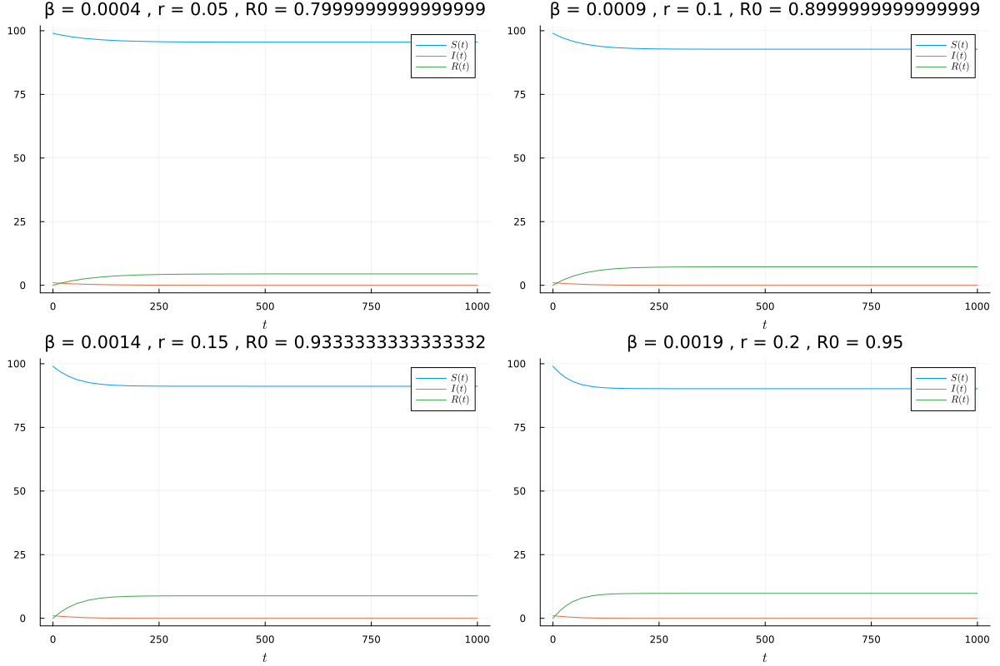

In [6]:
gr()

plot1 = plot(t,S[1:end,1] , title = "β = $(B[1]) , r = $(R_[1]) , R0 = $(r0[1])" , label =L"S(t)")
plot!(t,I[1:end,1] , label = L"I(t)")
plot!(t,R[1:end,1] , label = L"R(t)")

plot2 = plot(t,S[1:end,2] , title = "β = $(B[2]) , r = $(R_[2]) , R0 = $(r0[2])", label =L"S(t)")
plot!(t,I[1:end,2], label = L"I(t)")
plot!(t,R[1:end,2], label = L"R(t)")

plot3 = plot(t,S[1:end,3] , title = "β = $(B[3]) , r = $(R_[3]) , R0 = $(r0[3])", label =L"S(t)")
plot!(t,I[1:end,3], label = L"I(t)")
plot!(t,R[1:end,3], label = L"R(t)")


plot4 = plot(t,S[1:end,4] , title = "β = $(B[4]) , r = $(R_[4]) , R0 = $(r0[4])", label =L"S(t)")
plot!(t,I[1:end,4], label = L"I(t)")
plot!(t,R[1:end,4], label = L"R(t)")

plot(plot1,plot2,plot3,plot4 ,size=(1200,800) , xlabel = L"t")

### Phase Portrait

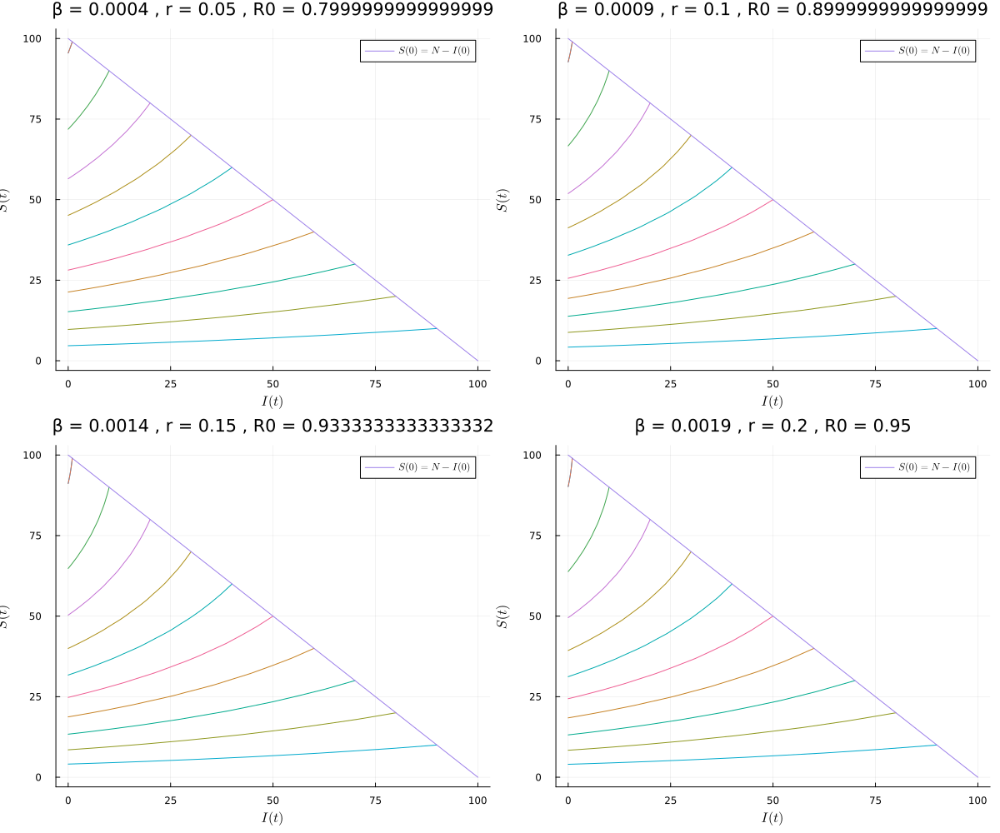

In [7]:
β = B[1]
r = R_[1]
Param = [β,r]
u0 = [N-1,1,0]
S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
fig1 = plot(I,S  , ylabel = L"S(t)" , xlabel = L"I(t)", label = false , title = "β = $(B[1]) , r = $(R_[1]) , R0 = $(r0[1])")
for j in 10:10:N
    plot!(I,S, label = false)
    u0 = [N-j,j,0]
    S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
end
plot!( range(0,N) , N .- range(0,N) , label = L"S(0) = N - I(0)")

β = B[2]
r = R_[2]
Param = [β,r]
u0 = [N-1,1,0]
S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
fig2 = plot(I,S  , ylabel = L"S(t)" , xlabel = L"I(t)", label = false , title = "β = $(B[2]) , r = $(R_[2]) , R0 = $(r0[2])")
for j in 10:10:N
    plot!(I,S, label = false)
    u0 = [N-j,j,0]
    S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
end
plot!( range(0,N) , N .- range(0,N) , label = L"S(0) = N - I(0)")

β = B[3]
r = R_[3]
Param = [β,r]
u0 = [N-1,1,0]
S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
fig3 = plot(I,S , ylabel = L"S(t)" , xlabel = L"I(t)", label = false , title = "β = $(B[3]) , r = $(R_[3]) , R0 = $(r0[3])")
for j in 10:10:N
    plot!(I,S, label = false)
    u0 = [N-j,j,0]
    S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
end
plot!( range(0,N) , N .- range(0,N) , label = L"S(0) = N - I(0)")

β = B[4]
r = R_[4]
Param = [β,r]
u0 = [N-1,1,0]
S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
fig4 = plot(I,S , ylabel = L"S(t)" , xlabel = L"I(t)" , label = false , title = "β = $(B[4]) , r = $(R_[4]) , R0 = $(r0[4])")
for j in 10:10:N
    plot!(I,S , label = false)
    u0 = [N-j,j,0]
    S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
end
plot!( range(0,N) , N .- range(0,N) , label = L"S(0) = N - I(0)")

plot(fig1,fig2,fig3,fig4, size = (1200,1000))

# Critical Case $R_0$ = 1

In [8]:
N = 100
Tf = 1000.0
nit = 1000
tspan = (0.0, Tf)
ϵ = 0

R_ = [.05,.1,.15,.2]
B = [q/N - ϵ for q in R_]
r0 = [R0(B[q],N,R_[q]) for q in 1:length(R_)] 

S = zeros(nit,length(R_))
I = zeros(nit,length(R_))
R = zeros(nit,length(R_))
t = range(0,Tf,nit)

for q in 1:length(R_)
    β = B[q]
    r = R_[q]
    Param = [β,r]
    u0 = [N-1,1,0]
    prob = ODEProblem(SIR , u0 , tspan , Param)
    sol = solve(prob,saveat=range(0,Tf,nit))
    for i in 1:length(sol.u)
        S[i,q] = sol.u[i][1]
        I[i,q] = sol.u[i][2]
        R[i,q] = sol.u[i][3]
    end
end

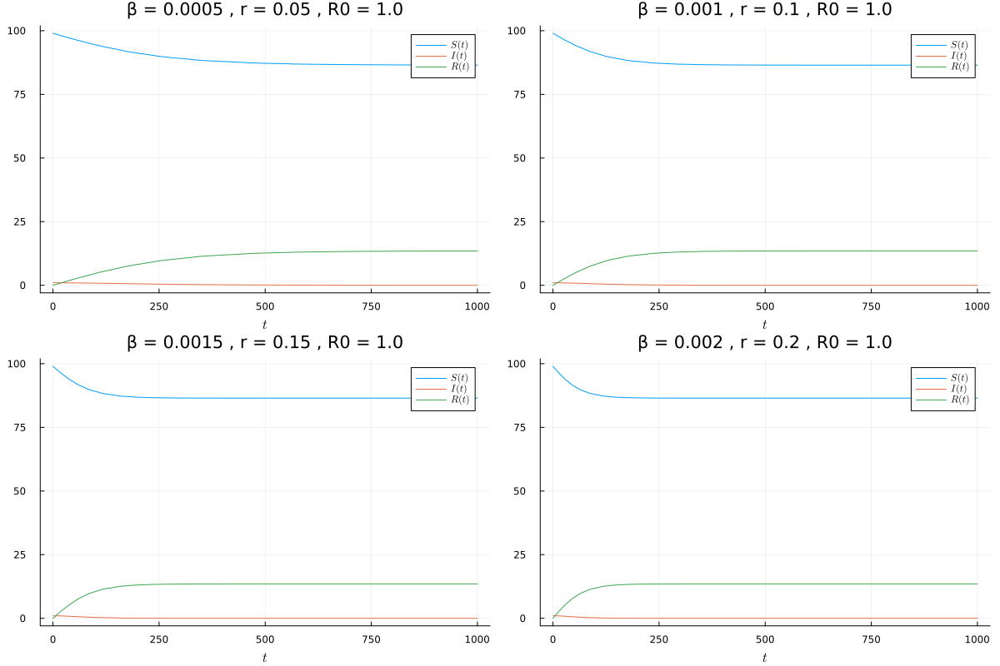

In [9]:
plot1 = plot(t,S[1:end,1] , title = "β = $(B[1]) , r = $(R_[1]) , R0 = $(r0[1])" , label =L"S(t)")
plot!(t,I[1:end,1], label = L"I(t)")
plot!(t,R[1:end,1], label = L"R(t)")

plot2 = plot(t,S[1:end,2] , title = "β = $(B[2]) , r = $(R_[2]) , R0 = $(r0[2])", label =L"S(t)")
plot!(t,I[1:end,2], label = L"I(t)")
plot!(t,R[1:end,2], label = L"R(t)")

plot3 = plot(t,S[1:end,3] , title = "β = $(B[3]) , r = $(R_[3]) , R0 = $(r0[3])", label =L"S(t)")
plot!(t,I[1:end,3], label = L"I(t)")
plot!(t,R[1:end,3], label = L"R(t)")


plot4 = plot(t,S[1:end,4] , title = "β = $(B[4]) , r = $(R_[4]) , R0 = $(r0[4])", label =L"S(t)")
plot!(t,I[1:end,4], label = L"I(t)")
plot!(t,R[1:end,4], label = L"R(t)")

plot(plot1,plot2,plot3,plot4 ,size=(1200,800) , xlabel = L"t")

### Phase Portrait

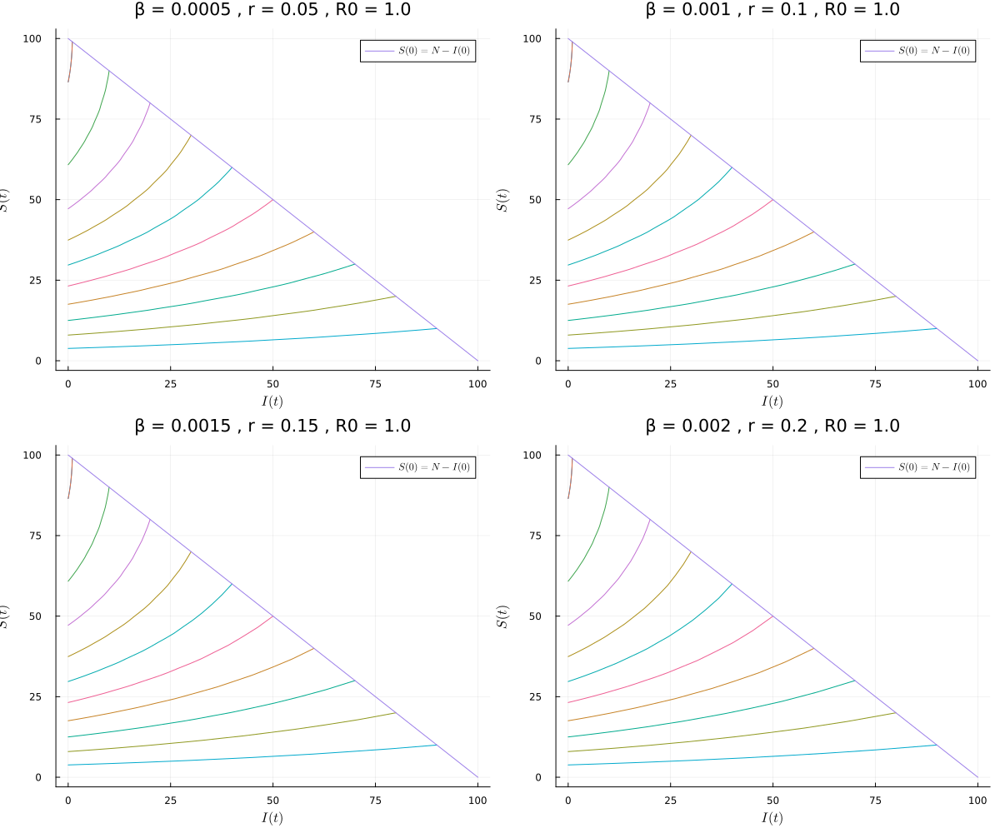

In [10]:
β = B[1]
r = R_[1]
Param = [β,r]
u0 = [N-1,1,0]
S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
fig1 = plot(I,S  , ylabel = L"S(t)" , xlabel = L"I(t)", label = false , title = "β = $(B[1]) , r = $(R_[1]) , R0 = $(r0[1])")
for j in 10:10:N
    plot!(I,S, label = false)
    u0 = [N-j,j,0]
    S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
end
plot!( range(0,N) , N .- range(0,N) , label = L"S(0) = N - I(0)")

β = B[2]
r = R_[2]
Param = [β,r]
u0 = [N-1,1,0]
S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
fig2 = plot(I,S  , ylabel = L"S(t)" , xlabel = L"I(t)", label = false , title = "β = $(B[2]) , r = $(R_[2]) , R0 = $(r0[2])")
for j in 10:10:N
    plot!(I,S, label = false)
    u0 = [N-j,j,0]
    S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
end
plot!( range(0,N) , N .- range(0,N) , label = L"S(0) = N - I(0)")

β = B[3]
r = R_[3]
Param = [β,r]
u0 = [N-1,1,0]
S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
fig3 = plot(I,S , ylabel = L"S(t)" , xlabel = L"I(t)", label = false , title = "β = $(B[3]) , r = $(R_[3]) , R0 = $(r0[3])")
for j in 10:10:N
    plot!(I,S, label = false)
    u0 = [N-j,j,0]
    S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
end
plot!( range(0,N) , N .- range(0,N) , label = L"S(0) = N - I(0)")

β = B[4]
r = R_[4]
Param = [β,r]
u0 = [N-1,1,0]
S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
fig4 = plot(I,S , ylabel = L"S(t)" , xlabel = L"I(t)" , label = false , title = "β = $(B[4]) , r = $(R_[4]) , R0 = $(r0[4])")
for j in 10:10:N
    plot!(I,S , label = false)
    u0 = [N-j,j,0]
    S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
end
plot!( range(0,N) , N .- range(0,N) , label = L"S(0) = N - I(0)")

plot(fig1,fig2,fig3,fig4, size = (1200,1000))

# Supercritical case $R_0 > 1$

In [11]:
N = 100
Tf = 1000.0
nit = 9000
tspan = (0.0, Tf)
ϵ = 0.0008

R_ = [.05,.1,.15,.2]
B = [q/N + ϵ for q in R_]
r0 = [R0(B[q],N,R_[q]) for q in 1:length(R_)] 

S = zeros(nit,length(R_))
I = zeros(nit,length(R_))
R = zeros(nit,length(R_))
t = range(0,Tf,nit)

for q in 1:length(R_)
    β = B[q]
    r = R_[q]
    Param = [β,r]
    u0 = [N-1,1,0]
    prob = ODEProblem(SIR , u0 , tspan , Param)
    sol = solve(prob,saveat=range(0,Tf,nit))
    for i in 1:length(sol.u)
        S[i,q] = sol.u[i][1]
        I[i,q] = sol.u[i][2]
        R[i,q] = sol.u[i][3]
    end
end

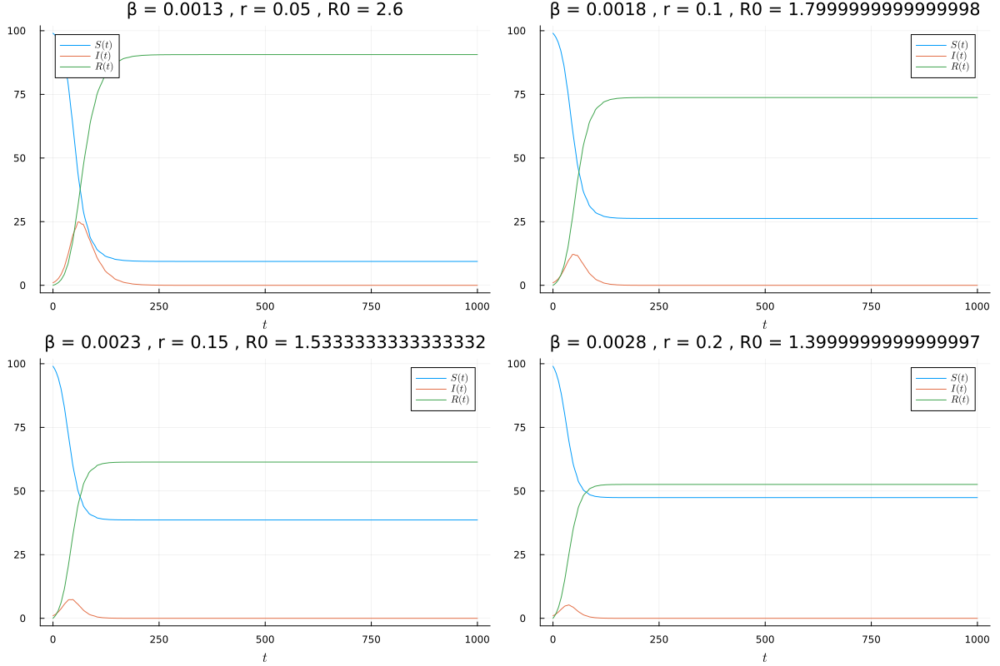

In [12]:
plot1 = plot(t,S[1:end,1] , title = "β = $(B[1]) , r = $(R_[1]) , R0 = $(r0[1])" , label =L"S(t)")
plot!(t,I[1:end,1], label = L"I(t)")
plot!(t,R[1:end,1], label = L"R(t)")

plot2 = plot(t,S[1:end,2] , title = "β = $(B[2]) , r = $(R_[2]) , R0 = $(r0[2])", label =L"S(t)")
plot!(t,I[1:end,2], label = L"I(t)")
plot!(t,R[1:end,2], label = L"R(t)")

plot3 = plot(t,S[1:end,3] , title = "β = $(B[3]) , r = $(R_[3]) , R0 = $(r0[3])", label =L"S(t)")
plot!(t,I[1:end,3], label = L"I(t)")
plot!(t,R[1:end,3], label = L"R(t)")


plot4 = plot(t,S[1:end,4] , title = "β = $(B[4]) , r = $(R_[4]) , R0 = $(r0[4])", label =L"S(t)")
plot!(t,I[1:end,4], label = L"I(t)")
plot!(t,R[1:end,4], label = L"R(t)")

plot(plot1,plot2,plot3,plot4 ,size=(1200,800) , xlabel = L"t")

### Phase Portrait

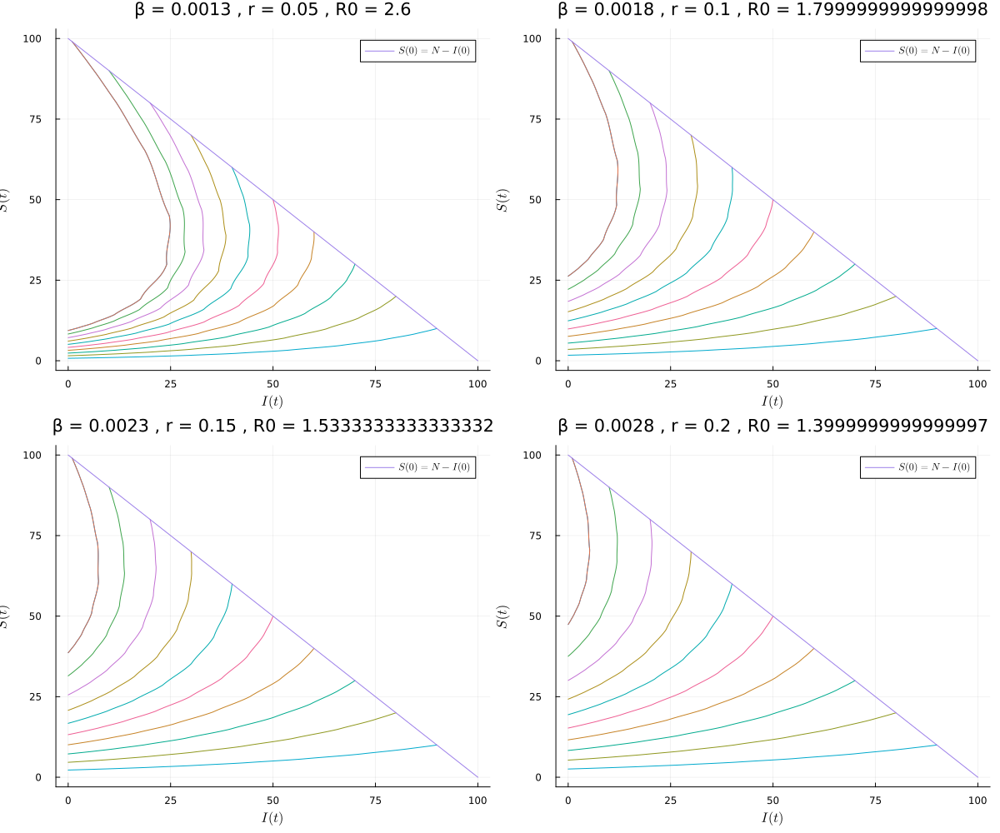

In [13]:
β = B[1]
r = R_[1]
Param = [β,r]
u0 = [N-1,1,0]
S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
fig1 = plot(I,S  , ylabel = L"S(t)" , xlabel = L"I(t)", label = false , title = "β = $(B[1]) , r = $(R_[1]) , R0 = $(r0[1])")
for j in 10:10:N
    plot!(I,S, label = false)
    u0 = [N-j,j,0]
    S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
end
plot!( range(0,N) , N .- range(0,N) , label = L"S(0) = N - I(0)")

β = B[2]
r = R_[2]
Param = [β,r]
u0 = [N-1,1,0]
S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
fig2 = plot(I,S  , ylabel = L"S(t)" , xlabel = L"I(t)", label = false , title = "β = $(B[2]) , r = $(R_[2]) , R0 = $(r0[2])")
for j in 10:10:N
    plot!(I,S, label = false)
    u0 = [N-j,j,0]
    S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
end
plot!( range(0,N) , N .- range(0,N) , label = L"S(0) = N - I(0)")

β = B[3]
r = R_[3]
Param = [β,r]
u0 = [N-1,1,0]
S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
fig3 = plot(I,S , ylabel = L"S(t)" , xlabel = L"I(t)", label = false , title = "β = $(B[3]) , r = $(R_[3]) , R0 = $(r0[3])")
for j in 10:10:N
    plot!(I,S, label = false)
    u0 = [N-j,j,0]
    S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
end
plot!( range(0,N) , N .- range(0,N) , label = L"S(0) = N - I(0)")

β = B[4]
r = R_[4]
Param = [β,r]
u0 = [N-1,1,0]
S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
fig4 = plot(I,S , ylabel = L"S(t)" , xlabel = L"I(t)" , label = false , title = "β = $(B[4]) , r = $(R_[4]) , R0 = $(r0[4])")
for j in 10:10:N
    plot!(I,S , label = false)
    u0 = [N-j,j,0]
    S , I , R = solve_SIR(Param, u0, Tf, nit::Int)
end
plot!( range(0,N) , N .- range(0,N) , label = L"S(0) = N - I(0)")

plot(fig1,fig2,fig3,fig4, size = (1200,1000))

We can write solution in an implicit form for $S(t) , I(t) , R(t)$

$$ S(t) = S(0) exp \left( -\int_0^t \beta I(s) ds \right)$$

$$ I(t) = I(0) exp \left( \int_0^t \beta (I(s) - r) ds\right) $$

$$ R(t) = R(0) + \int_0^t r I(s) ds $$

$$ S(t) + I(t) + R(t) = N$$

We notice that

$$ S(t) = S(0) exp\left( \frac{-\beta}{r}  (R(t) - R(0))\right)$$

We can write

$$ \frac{dR}{dt} = r (N - S(t) - R(t)) $$

Then

$$ \frac{dR(t)}{dt} = r (N - R(t) - S(0) exp\left( \frac{-\beta}{r}  (R(t) - R(0))\right) ) $$

We have $ \frac{dR(t)}{dt} \rightarrow 0 $ as $t \rightarrow \infty$. Then we have the following fix-point equation

$$ R(t) = N - S(0) exp\left( \frac{-\beta}{r}  (R(t) - R(0))\right) $$

The initial conditions are

$$ \frac{S(0)}{N} = 1 - \epsilon $$

$$ \frac{I(0)}{N} = \epsilon $$

$$ R(0) = 0$$

Then we have 

$$ r(t) = 1 - (1-\epsilon) e^{-R_0 r} $$

$$ \frac{dr}{dR_0} = \frac{(1-\epsilon)re^{-R_0 r}}{1 - (1-\epsilon)R_0e^{-R_0r}}$$

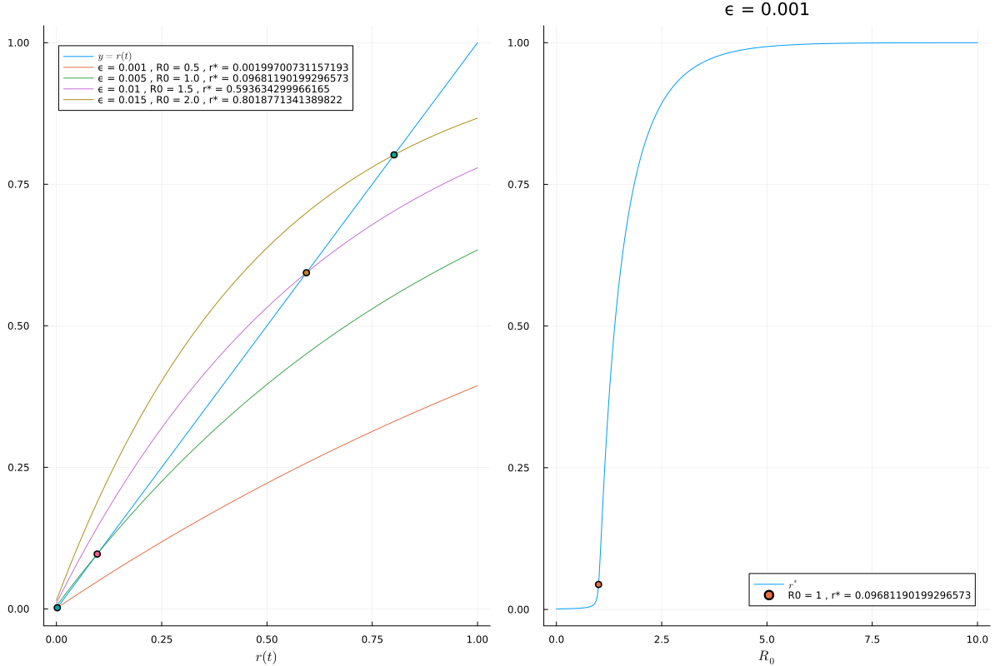

In [14]:
r = range(0,1,100)
R0_val = range(0.5 , 2.0 , 4)
R_0 = range(.0,10,1000)
Ε = [.001,.005,.010,.015]

function rt(r,ϵ,R0)
    return 1  - (1-ϵ) * exp( - R0 * r)
end

function r_fixed_point(ϵ,r_0)
    return find_zero(x -> rt(x,ϵ , r_0) - x, .5)
end

r1 = r_fixed_point( Ε[1] , R0_val[1] )
r2 = r_fixed_point( Ε[2] , R0_val[2] )
r3 = r_fixed_point( Ε[3] , R0_val[3] )
r4 = r_fixed_point( Ε[4] , R0_val[4] )
r_fixed = r_fixed_point.(.001 , R_0)

plot1 = plot(r,r , label = L"y=r(t)" , xlabel = L"r(t)" , size = (1200,800))
plot!(r , rt.(r, Ε[1] ,R0_val[1]) , label = "ϵ = $(Ε[1]) , R0 = $(R0_val[1]) , r* = $(r1)")
plot!(r , rt.(r, Ε[2] ,R0_val[2]) , label = "ϵ = $(Ε[2]) , R0 = $(R0_val[2]) , r* = $(r2)")
plot!(r , rt.(r, Ε[3] ,R0_val[3]) , label = "ϵ = $(Ε[3]) , R0 = $(R0_val[3]) , r* = $(r3)")
plot!(r , rt.(r, Ε[4] ,R0_val[4]) , label = "ϵ = $(Ε[4]) , R0 = $(R0_val[4]) , r* = $(r4)")

scatter!([r1],[r1] , label = false)
scatter!([r2],[r2] , label = false)
scatter!([r3],[r3] , label = false)
scatter!([r4],[r4] , label = false)

plot2 = plot(R_0 , r_fixed , xlabel = L"R_0" , title = "ϵ = $(0.001)" , label = L"r^{*}")
scatter!([1] , [r_fixed_point( .001 , 1.0 )] , label = "R0 = 1 , r* = $(r2)")
plot(plot1,plot2)

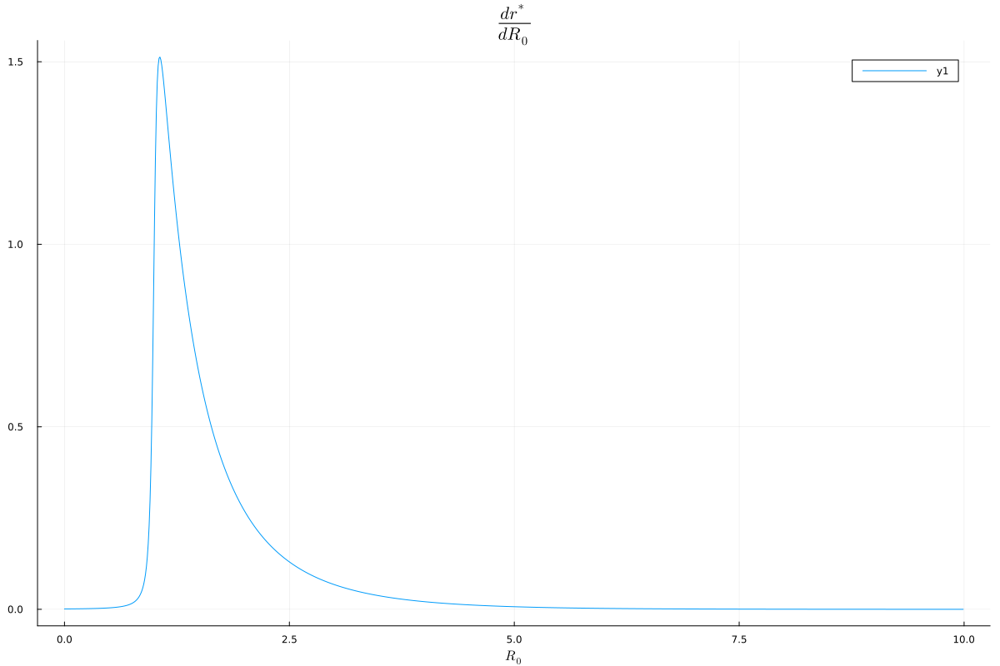

In [15]:
drdR0 = (r_fixed[2:end] - r_fixed[1:end-1]) ./ (R_0[2:end] - R_0[1:end-1])
plot(R_0[1:end-1] , drdR0 , size = (1200,800) , title = L"\frac{dr^{*}}{dR_0}" , xlabel = L"R_0")

# Exercice II

In [16]:
function Infection( G::Graph , p , nit , I0=1)
    ### Infection with Recovery
    nodes = nv(G)
    S_Matrix = ones(Int , nit , nv(G) )
    I_Matrix = zeros(Int , nit , nv(G) )
    R_Matrix = zeros(Int , nit , nv(G) )
    
    S_Matrix[1:end,I0] .= 0
    I_Matrix[1,I0] = 1
    R_Matrix[2:end,I0] .= 1  
    for q in 1:nit-1
        for j in 1:nodes
            if (I_Matrix[q,j] == 1) && (R_Matrix[q,j] == 0)
                for k in neighbors(G , j)
                    if( rand() < p ) && (R_Matrix[q,k] == 0) && (I_Matrix[q,k] == 0)
                        S_Matrix[q+1:end,k] .= 0
                        I_Matrix[q+1,k] = 1
                        R_Matrix[q+2:end,k] .= 1      
                    end
                end
            end
        end
    end
    return S_Matrix , I_Matrix , R_Matrix
end

function Infection_sim(G::Graph , p , nit , nsim,I0=1)
    S_av = zeros(nit)
    I_av = zeros(nit)
    R_av = zeros(nit)
    for q in 1:nsim
        S , I , R = Infection(G,p,nit,I0)
        S_av[1:end] .= S_av[1:end] .+ sum(S,dims=2) / nsim
        I_av[1:end] .= I_av[1:end] .+ sum(I,dims=2) / nsim
        R_av[1:end] .= R_av[1:end] .+ sum(R,dims=2) / nsim
    end
    return S_av , I_av , R_av
end

function statistics( G::Graph , p , nit , nsim)
    N = nv(G)
    I_max = 0
    prop_infect = 0
    clear_I = 0
    nodes = [q for q in 1:N]
    for q in 1:nsim
        I0 = rand(nodes)
        S_matrix , I_matrix , R_matrix = Infection(G,p,nit,I0)
        S = vec( sum(S_matrix , dims = 2) )
        I = vec( sum(I_matrix , dims = 2) )
        R = vec( sum(R_matrix , dims = 2) )
        
        clear_I += findfirst(x -> x ==0 , I) / nsim
        I_max += argmax(I) / nsim
        prop_infect += (R[end] / N) / nsim
    end
    return [ prop_infect , I_max , clear_I]
end

statistics (generic function with 1 method)

In [17]:
N = 100     ### Number of nodes
nit = 200   ### Number of Iterations
nsim = 500  ### Number of Simulations

p1 = .4     ### Probability of Infection
p2 = .45    ### Probability of Infection
p3 = .5     ### Probability of Infection
p4 = .55    ### Probability of Infection

0.55

### Square Graph

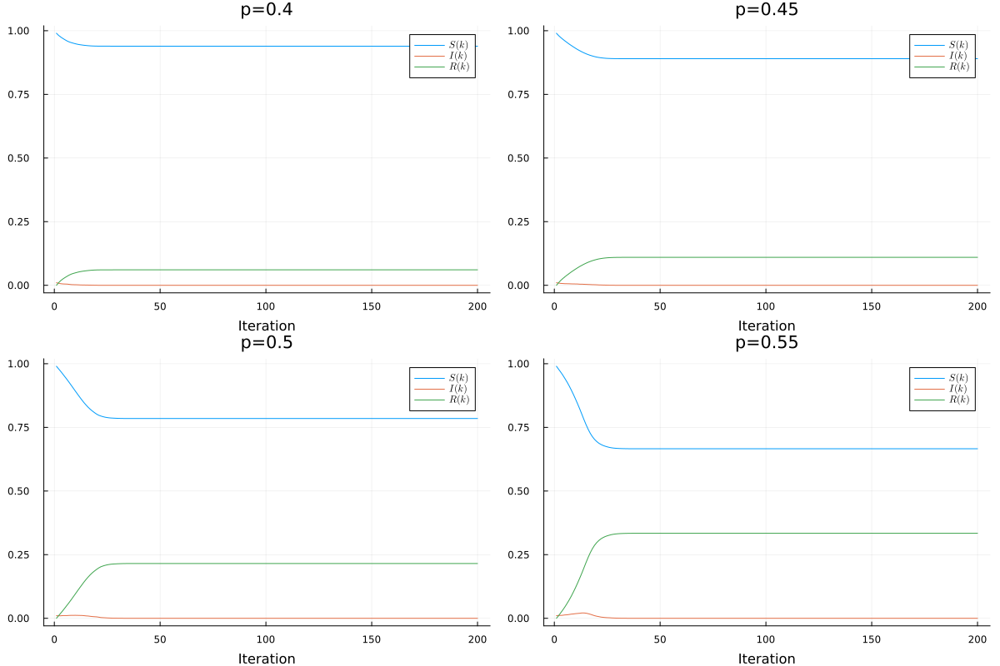

In [18]:
G1 = Graphs.grid([Int(sqrt(N)) , Int(sqrt(N))])

S1 , I1 , R1 = Infection_sim(G1 , p1 , nit , nsim)
S2 , I2 , R2 = Infection_sim(G1 , p2 , nit , nsim)
S3 , I3 , R3 = Infection_sim(G1 , p3 , nit , nsim)
S4 , I4 , R4 = Infection_sim(G1 , p4 , nit , nsim)

plot1 = plot(S1 / N , label = L"S(k)" , title = "p=$(p1)")
plot!(I1 / N , label = L"I(k)")
plot!(R1 / N , label = L"R(k)")

plot2 = plot(S2 / N , label = L"S(k)" , title = "p=$(p2)")
plot!(I2 / N , label = L"I(k)")
plot!(R2 / N , label = L"R(k)")

plot3 = plot(S3 / N , label = L"S(k)" , title = "p=$(p3)")
plot!(I3 / N , label = L"I(k)")
plot!(R3 / N , label = L"R(k)")

plot4 = plot(S4 / N , label = L"S(k)" , title = "p=$(p4)")
plot!(I4 / N , label = L"I(k)")
plot!(R4 / N , label = L"R(k)")

plot(plot1 , plot2 , plot3 , plot4 , size = (1200 , 800) , xlabel = "Iteration")

### Random Graph

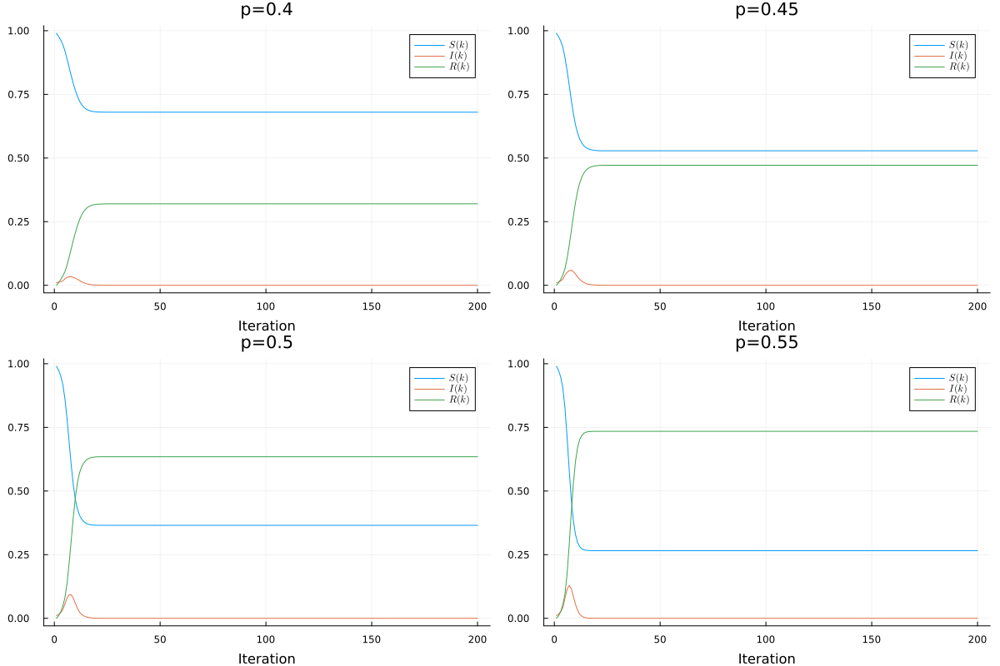

In [19]:
G2 = watts_strogatz(N , 4 , 1)

S1 , I1 , R1 = Infection_sim(G2 , p1 , nit , nsim)
S2 , I2 , R2 = Infection_sim(G2 , p2 , nit , nsim)
S3 , I3 , R3 = Infection_sim(G2 , p3 , nit , nsim)
S4 , I4 , R4 = Infection_sim(G2 , p4 , nit , nsim)

plot1 = plot(S1 / N , label = L"S(k)" , title = "p=$(p1)")
plot!(I1 / N , label = L"I(k)")
plot!(R1 / N , label = L"R(k)")

plot2 = plot(S2 / N , label = L"S(k)" , title = "p=$(p2)")
plot!(I2 / N , label = L"I(k)")
plot!(R2 / N , label = L"R(k)")

plot3 = plot(S3 / N , label = L"S(k)" , title = "p=$(p3)")
plot!(I3 / N , label = L"I(k)")
plot!(R3 / N , label = L"R(k)")

plot4 = plot(S4 / N , label = L"S(k)" , title = "p=$(p4)")
plot!(I4 / N , label = L"I(k)")
plot!(R4 / N , label = L"R(k)")

plot(plot1 , plot2 , plot3 , plot4 , size = (1200 , 800) , xlabel = "Iteration")

### Watts Strogaz Network

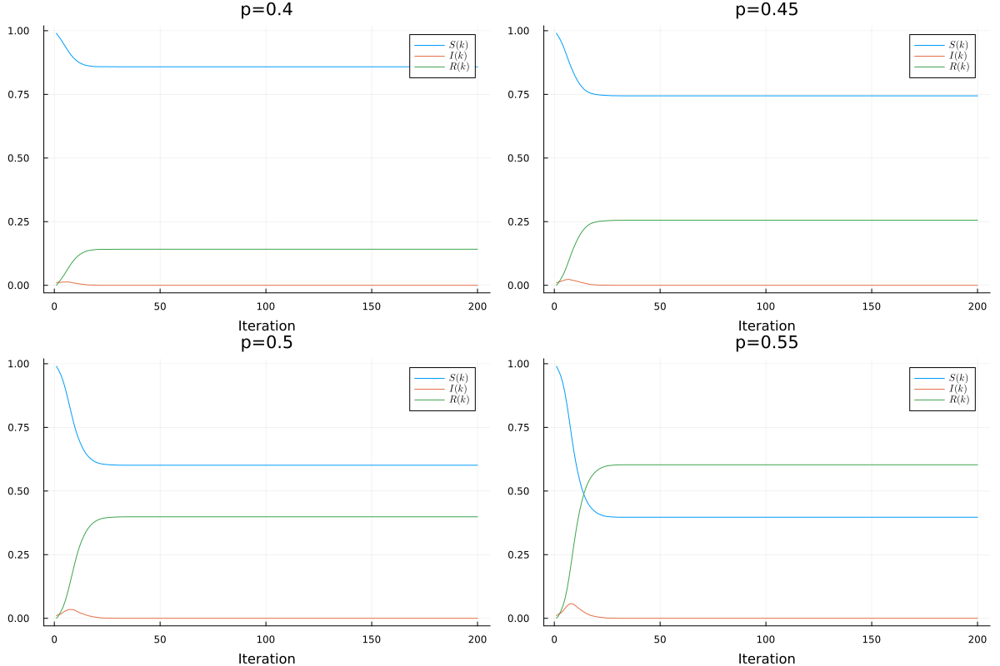

In [20]:
G3 = watts_strogatz(N , 4 , .1)

S1 , I1 , R1 = Infection_sim(G3 , p1 , nit , nsim)
S2 , I2 , R2 = Infection_sim(G3 , p2 , nit , nsim)
S3 , I3 , R3 = Infection_sim(G3 , p3 , nit , nsim)
S4 , I4 , R4 = Infection_sim(G3 , p4 , nit , nsim)

plot1 = plot(S1 / N , label = L"S(k)" , title = "p=$(p1)")
plot!(I1 / N , label = L"I(k)")
plot!(R1 / N , label = L"R(k)")

plot2 = plot(S2 / N , label = L"S(k)" , title = "p=$(p2)")
plot!(I2 / N , label = L"I(k)")
plot!(R2 / N , label = L"R(k)")

plot3 = plot(S3 / N , label = L"S(k)" , title = "p=$(p3)")
plot!(I3 / N , label = L"I(k)")
plot!(R3 / N , label = L"R(k)")

plot4 = plot(S4 / N , label = L"S(k)" , title = "p=$(p4)")
plot!(I4 / N , label = L"I(k)")
plot!(R4 / N , label = L"R(k)")

plot(plot1 , plot2 , plot3 , plot4 , size = (1200 , 800) , xlabel = "Iteration")

### Barabasi Albert model

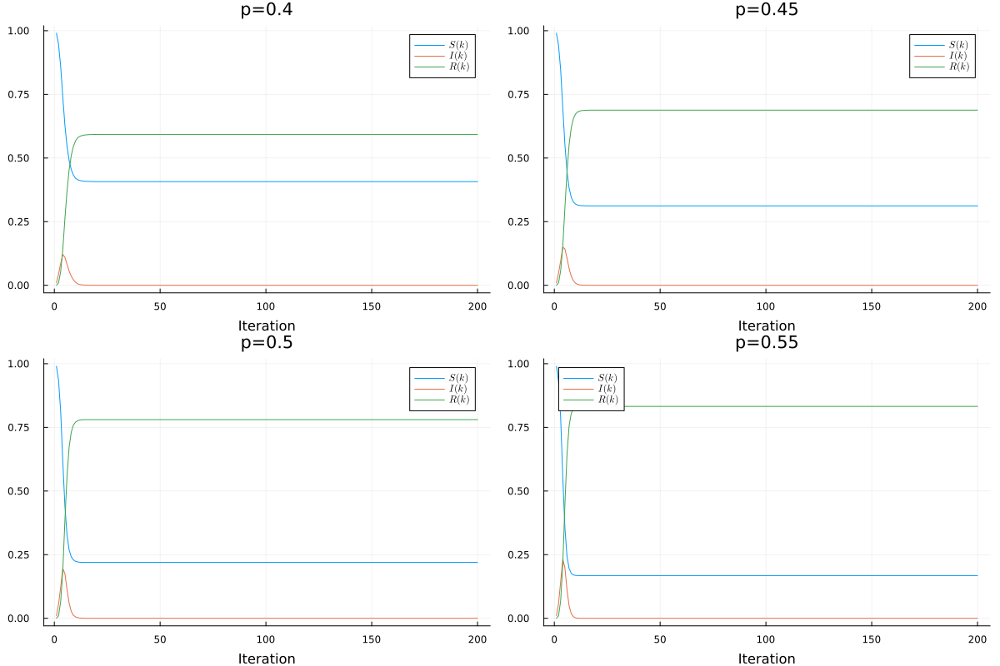

In [21]:
G4 = barabasi_albert(N , 2)

S1 , I1 , R1 = Infection_sim(G4 , p1 , nit , nsim)
S2 , I2 , R2 = Infection_sim(G4 , p2 , nit , nsim)
S3 , I3 , R3 = Infection_sim(G4 , p3 , nit , nsim)
S4 , I4 , R4 = Infection_sim(G4 , p4 , nit , nsim)

plot1 = plot(S1 / N , label = L"S(k)" , title = "p=$(p1)")
plot!(I1 / N , label = L"I(k)")
plot!(R1 / N , label = L"R(k)")

plot2 = plot(S2 / N , label = L"S(k)" , title = "p=$(p2)")
plot!(I2 / N , label = L"I(k)")
plot!(R2 / N , label = L"R(k)")

plot3 = plot(S3 / N , label = L"S(k)" , title = "p=$(p3)")
plot!(I3 / N , label = L"I(k)")
plot!(R3 / N , label = L"R(k)")

plot4 = plot(S4 / N , label = L"S(k)" , title = "p=$(p4)")
plot!(I4 / N , label = L"I(k)")
plot!(R4 / N , label = L"R(k)")

plot(plot1 , plot2 , plot3 , plot4 , size = (1200 , 800) , xlabel = "Iteration" )

c) We see that the discrete model reproduces welll the continuous curves. However, the model becomes strongly dependent on the network topological parameters and the rate parameters $\beta,\gamma,R_0$ lose their meaning

d)

### Square Graph

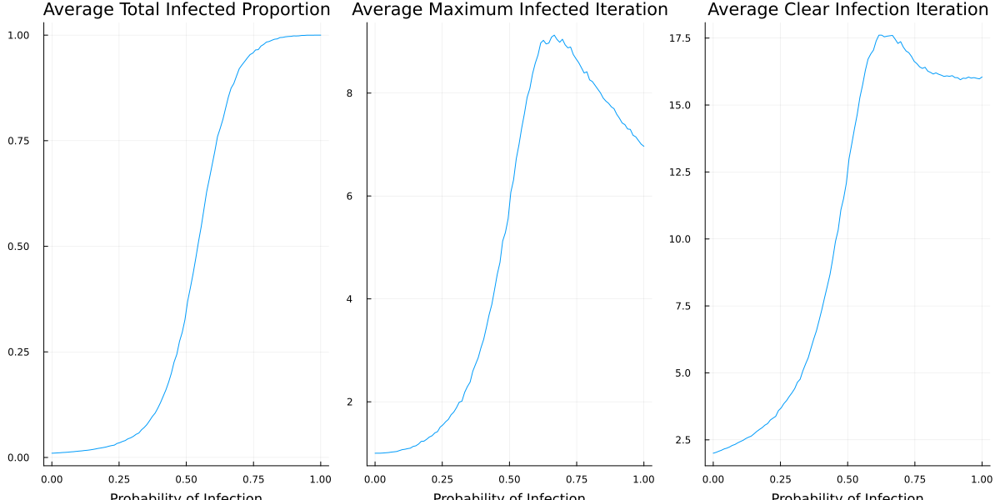

In [22]:
N = 100             ### Number of nodes
p = range(0,1,100)  ### Proabilities Range
nit = 200           ### Number of Iterations
nsim = 5000         ### Number of SImulations

G1 = Graphs.grid([Int(sqrt(N)) , Int(sqrt(N))])

Stats = map( x -> statistics(G1 , x , nit , nsim) , p )
prop_infect = [q[1] for q in Stats]
I_max = [q[2] for q in Stats]
clear_I = [q[3] for q in Stats]

plot1 = plot(p,prop_infect , title = "Average Total Infected Proportion" , label =false)
plot2 = plot(p,I_max , title = "Average Maximum Infected Iteration", label =false)
plot3 = plot(p,clear_I , title = "Average Clear Infection Iteration", label =false)

plot(plot1 , plot2 , plot3, xlabel ="Probability of Infection" , size = (1200,600) , layout=(1,3))

### Random Graph

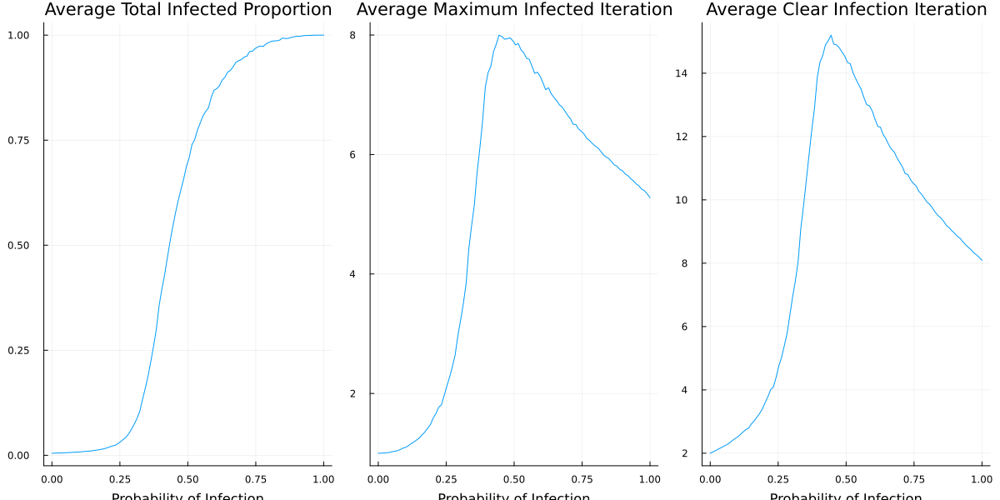

In [23]:
N = 200             ### Number of nodes
p = range(0,1,100)  ### Proabilities Range
nit = 200           ### Number of Iterations
nsim = 5000         ### Number of SImulations

G2 = watts_strogatz(N , 5 , 1)

Stats = map( x -> statistics(G2 , x , nit , nsim) , p )
prop_infect = [q[1] for q in Stats]
I_max = [q[2] for q in Stats]
clear_I = [q[3] for q in Stats]

plot1 = plot(p,prop_infect , title = "Average Total Infected Proportion" , label =false)
plot2 = plot(p,I_max , title = "Average Maximum Infected Iteration", label =false)
plot3 = plot(p,clear_I , title = "Average Clear Infection Iteration", label =false)

plot(plot1 , plot2 , plot3, xlabel ="Probability of Infection" , size = (1200,600) , layout=(1,3))

### Watts-Strogatz Graph

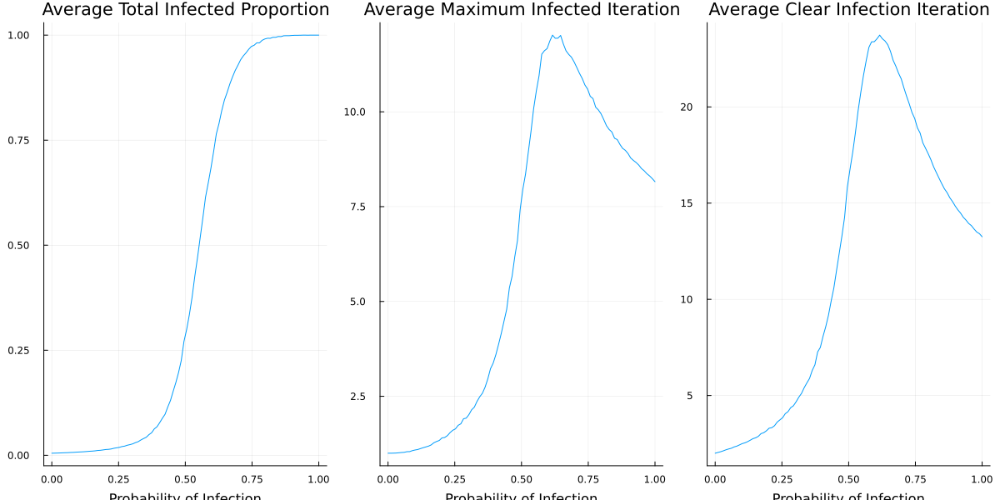

In [24]:
N = 200             ### Number of nodes
p = range(0,1,100)  ### Proabilities Range
nit = 200           ### Number of Iterations
nsim = 5000         ### Number of SImulations

G3 = watts_strogatz(N , 5 , .1)

Stats = map( x -> statistics(G3 , x , nit , nsim) , p )
prop_infect = [q[1] for q in Stats]
I_max = [q[2] for q in Stats]
clear_I = [q[3] for q in Stats]

plot1 = plot(p,prop_infect , title = "Average Total Infected Proportion" , label =false)
plot2 = plot(p,I_max , title = "Average Maximum Infected Iteration", label =false)
plot3 = plot(p,clear_I , title = "Average Clear Infection Iteration", label =false)

plot(plot1 , plot2 , plot3, xlabel ="Probability of Infection" , size = (1200,600) , layout=(1,3))

### Albert-Barabasi Graph

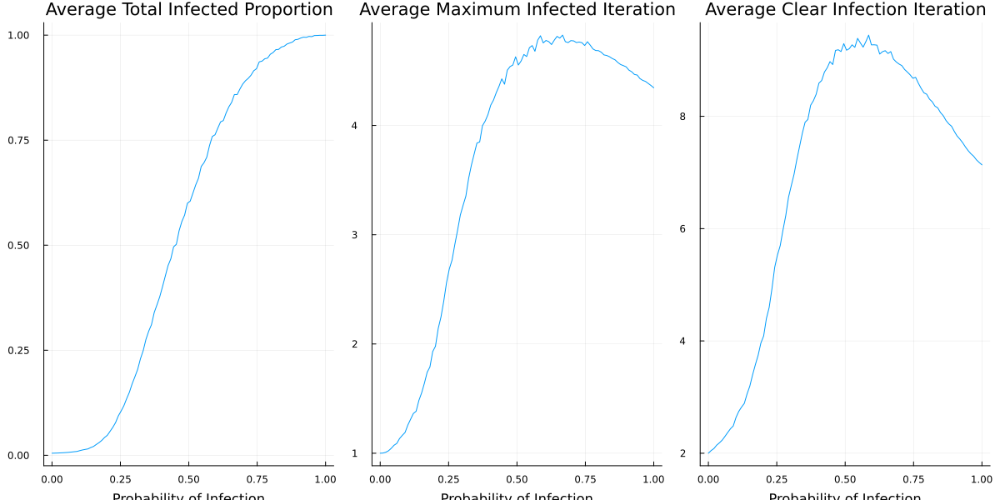

In [25]:
N = 200             ### Number of nodes
p = range(0,1,100)  ### Proabilities Range
nit = 200           ### Number of Iterations
nsim = 5000         ### Number of SImulations

G4 = barabasi_albert(N , 2)

Stats = map( x -> statistics(G4 , x , nit , nsim) , p )
prop_infect = [q[1] for q in Stats]
I_max = [q[2] for q in Stats]
clear_I = [q[3] for q in Stats]

plot1 = plot(p,prop_infect , title = "Average Total Infected Proportion" , label =false)
plot2 = plot(p,I_max , title = "Average Maximum Infected Iteration", label =false)
plot3 = plot(p,clear_I , title = "Average Clear Infection Iteration", label =false)

plot(plot1 , plot2 , plot3, xlabel ="Probability of Infection" , size = (1200,600) , layout=(1,3))

e)

f) 

In [26]:
N = 25      ### Number of nodes
nit = 25   ### Number of Iterations
p = .7      ### Infection Probability

0.7

### Square Graph

┌ Info: Saved animation to /tmp/jl_9wvYbmlGty.gif
└ @ Plots /home/lucas/.julia/packages/Plots/a3u1v/src/animation.jl:156


Plots.AnimatedGif("/tmp/jl_9wvYbmlGty.gif")
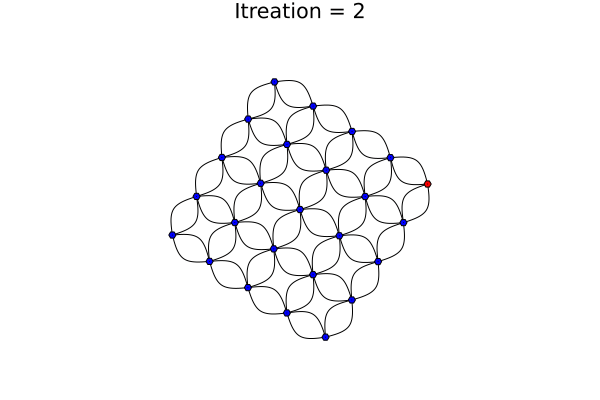

In [27]:
G1 = Graphs.grid([Int(sqrt(N)) , Int(sqrt(N))])
S , I , R = Infection(G1 , p , nit)
Colors = [ R[q,j] == 1 ? :red : :blue  for q in 1:nit , j in 1:nv(G1)]

plot(G1, nodecolor=Colors[1,1:end])
anim = @animate for q in 2:nit
    plot(G1, nodecolor=nodecolor=Colors[q,1:end],title="Itreation = $(q)")
end
gif(anim, fps=1)

### Random Graph

┌ Info: Saved animation to /tmp/jl_nArM1i3k7O.gif
└ @ Plots /home/lucas/.julia/packages/Plots/a3u1v/src/animation.jl:156


Plots.AnimatedGif("/tmp/jl_nArM1i3k7O.gif")
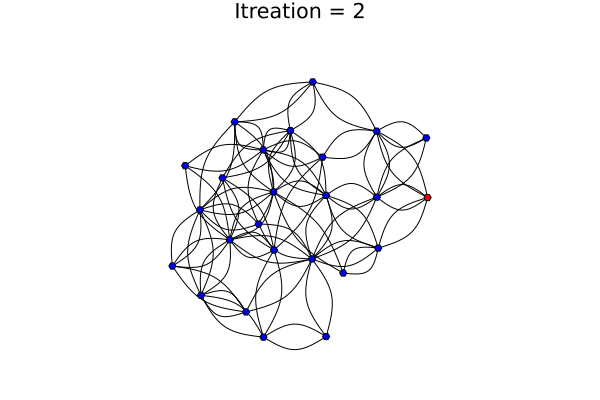

In [28]:
G2 = watts_strogatz(N , 4 , 1)
S , I , R = Infection(G2 , p , nit)
Colors = [ R[q,j] == 1 ? :red : :blue for q in 1:nit , j in 1:nv(G1)]

plot(G2, nodecolor=Colors[1,1:end])
anim = @animate for q in 2:nit
    plot(G2, nodecolor=nodecolor=Colors[q,1:end],title="Itreation = $(q)")
end
gif(anim, fps=1)

### Watts-Strogatz

┌ Info: Saved animation to /tmp/jl_1aNy969YZU.gif
└ @ Plots /home/lucas/.julia/packages/Plots/a3u1v/src/animation.jl:156


Plots.AnimatedGif("/tmp/jl_1aNy969YZU.gif")
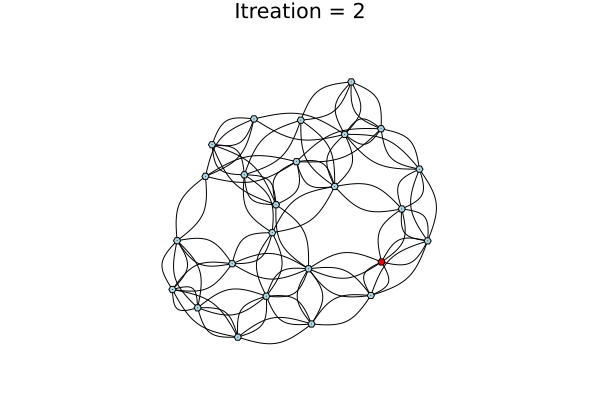

In [29]:
G3 = watts_strogatz(N , 4 , .1)
S , I , R = Infection(G1 , p , nit)
Colors = [ R[q,j] == 1 ? :red : :lightblue  for q in 1:nit , j in 1:nv(G1)]

plot(G3, nodecolor=Colors[1,1:end])
anim = @animate for q in 2:nit
    plot(G3, nodecolor=nodecolor=Colors[q,1:end],title="Itreation = $(q)")
end
gif(anim, fps=1)

### Albert-Barabasi

┌ Info: Saved animation to /tmp/jl_7w36tarkN8.gif
└ @ Plots /home/lucas/.julia/packages/Plots/a3u1v/src/animation.jl:156


Plots.AnimatedGif("/tmp/jl_7w36tarkN8.gif")
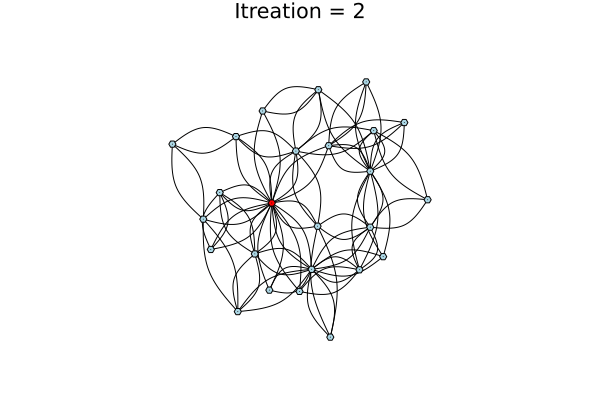

In [30]:
G4 = barabasi_albert(N , 2)
S , I , R = Infection(G1 , p , nit)
Colors = [ R[q,j] == 1 ? :red : :lightblue  for q in 1:nit , j in 1:nv(G1)]

plot(G4, nodecolor=Colors[1,1:end])
anim = @animate for q in 2:nit
    plot(G4, nodecolor=nodecolor=Colors[q,1:end],title="Itreation = $(q)")
end
gif(anim, fps=1)

# Exercice III

In [31]:
function Infection_asynchronous( G::Graph , p , nit , I0=1)
    ### Infection with Recovery
    nodes = nv(G)
    S_Matrix = ones(Int , nit , nv(G) )
    I_Matrix = zeros(Int , nit , nv(G) )
    R_Matrix = zeros(Int , nit , nv(G) )
    
    S_Matrix[1:end,I0] .= 0
    I_Matrix[1,I0] = 1
    R_Matrix[2:end,I0] .= 1  
    for q in 1:nit-1
        I = rand(1:nodes)
        if( I_Matrix[q,I] == 1)
            for k in neighbors(G,I)
                if( rand() < p ) && (R_Matrix[q,k] == 0) && (I_Matrix[q,k] == 0)
                    S_Matrix[q+1:end,k] .= 0
                    I_Matrix[q+1,k] = 1
                    R_Matrix[q+2:end,k] .= 1      
                end
            end
        else
            S_Matrix[q+1,1:end] .= S_Matrix[q,1:end]
            I_Matrix[q+1,1:end] .= I_Matrix[q,1:end]
            R_Matrix[q+1,1:end] .= R_Matrix[q,1:end]
        end
    end
    return S_Matrix , I_Matrix , R_Matrix
end

function Infection_sim_asynchronous(G::Graph , p , nit , nsim,I0=1)
    S_av = zeros(nit)
    I_av = zeros(nit)
    R_av = zeros(nit)
    for q in 1:nsim
        S , I , R = Infection_asynchronous(G,p,nit,I0)
        S_av[1:end] .= S_av[1:end] .+ sum(S,dims=2) / nsim
        I_av[1:end] .= I_av[1:end] .+ sum(I,dims=2) / nsim
        R_av[1:end] .= R_av[1:end] .+ sum(R,dims=2) / nsim
    end
    return S_av , I_av , R_av
end

Infection_sim_asynchronous (generic function with 2 methods)

In [32]:
N = 100     ### Number of nodes
nit = 2000   ### Number of Iterations
nsim = 500  ### Number of Simulations

p1 = .4     ### Probability of Infection
p2 = .45    ### Probability of Infection
p3 = .5     ### Probability of Infection
p4 = .55    ### Probability of Infection

0.55

### Square Graph

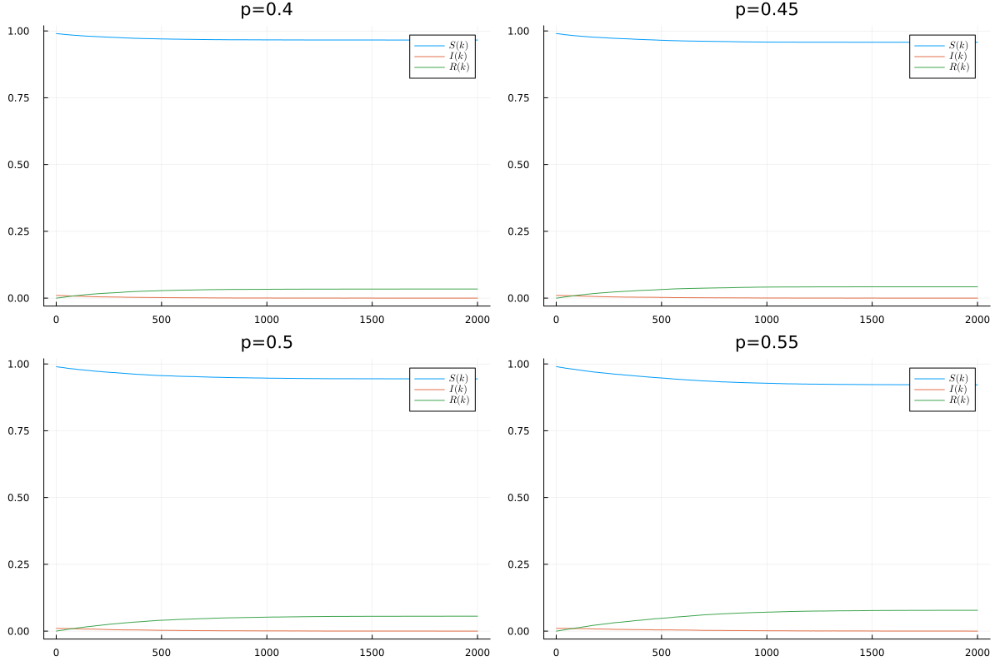

In [33]:
G1 = Graphs.grid([10,10])

S1 , I1 , R1 = Infection_sim_asynchronous(G1 , p1 , nit , nsim)
S2 , I2 , R2 = Infection_sim_asynchronous(G1 , p2 , nit , nsim)
S3 , I3 , R3 = Infection_sim_asynchronous(G1 , p3 , nit , nsim)
S4 , I4 , R4 = Infection_sim_asynchronous(G1 , p4 , nit , nsim)

plot1 = plot(S1 / N , label = L"S(k)" , title = "p=$(p1)")
plot!(I1 / N , label = L"I(k)")
plot!(R1 / N , label = L"R(k)")

plot2 = plot(S2 / N , label = L"S(k)" , title = "p=$(p2)")
plot!(I2 / N , label = L"I(k)")
plot!(R2 / N , label = L"R(k)")

plot3 = plot(S3 / N , label = L"S(k)" , title = "p=$(p3)")
plot!(I3 / N , label = L"I(k)")
plot!(R3 / N , label = L"R(k)")

plot4 = plot(S4 / N , label = L"S(k)" , title = "p=$(p4)")
plot!(I4 / N , label = L"I(k)")
plot!(R4 / N , label = L"R(k)")

plot(plot1 , plot2 , plot3 , plot4 , size = (1200 , 800))

### Random Graph

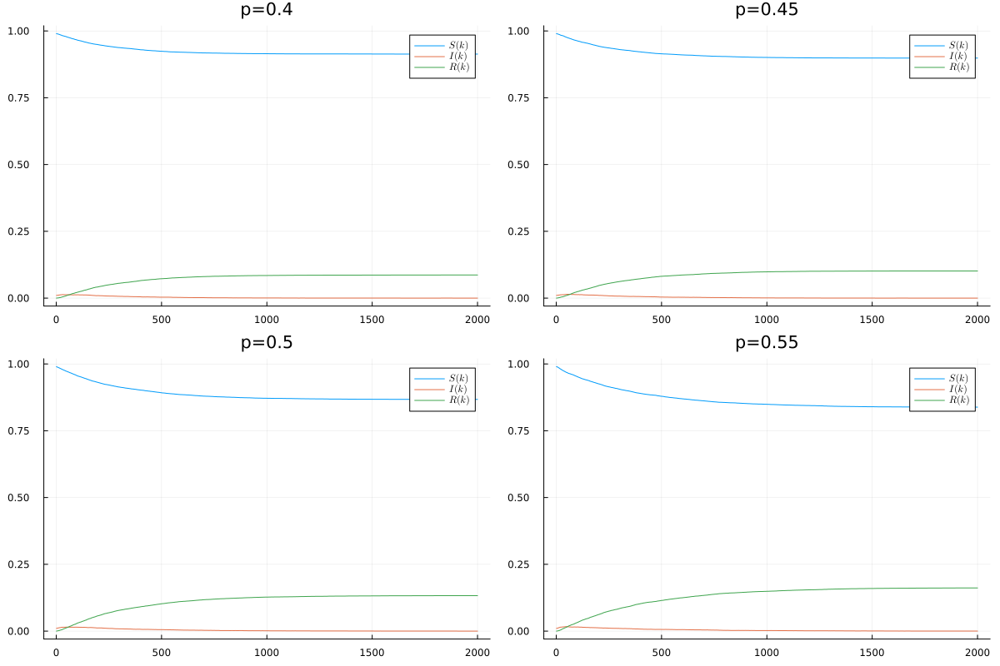

In [34]:
G2 = watts_strogatz(N , 4 , 1)

S1 , I1 , R1 = Infection_sim_asynchronous(G2 , p1 , nit , nsim)
S2 , I2 , R2 = Infection_sim_asynchronous(G2 , p2 , nit , nsim)
S3 , I3 , R3 = Infection_sim_asynchronous(G2 , p3 , nit , nsim)
S4 , I4 , R4 = Infection_sim_asynchronous(G2 , p4 , nit , nsim)

plot1 = plot(S1 / N , label = L"S(k)" , title = "p=$(p1)")
plot!(I1 / N , label = L"I(k)")
plot!(R1 / N , label = L"R(k)")

plot2 = plot(S2 / N , label = L"S(k)" , title = "p=$(p2)")
plot!(I2 / N , label = L"I(k)")
plot!(R2 / N , label = L"R(k)")

plot3 = plot(S3 / N , label = L"S(k)" , title = "p=$(p3)")
plot!(I3 / N , label = L"I(k)")
plot!(R3 / N , label = L"R(k)")

plot4 = plot(S4 / N , label = L"S(k)" , title = "p=$(p4)")
plot!(I4 / N , label = L"I(k)")
plot!(R4 / N , label = L"R(k)")

plot(plot1 , plot2 , plot3 , plot4 , size = (1200 , 800) )

### Watts-Strogaz Graph

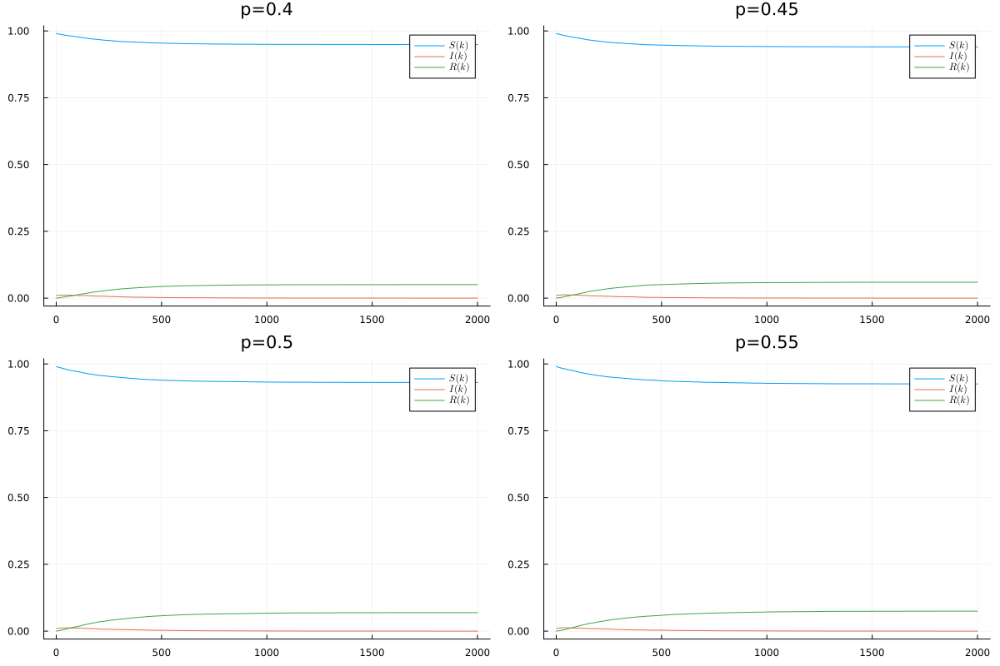

In [35]:
G3 = watts_strogatz(N , 4 , .1)

S1 , I1 , R1 = Infection_sim_asynchronous(G3 , p1 , nit , nsim)
S2 , I2 , R2 = Infection_sim_asynchronous(G3 , p2 , nit , nsim)
S3 , I3 , R3 = Infection_sim_asynchronous(G3 , p3 , nit , nsim)
S4 , I4 , R4 = Infection_sim_asynchronous(G3 , p4 , nit , nsim)

plot1 = plot(S1 / N , label = L"S(k)" , title = "p=$(p1)")
plot!(I1 / N , label = L"I(k)")
plot!(R1 / N , label = L"R(k)")

plot2 = plot(S2 / N , label = L"S(k)" , title = "p=$(p2)")
plot!(I2 / N , label = L"I(k)")
plot!(R2 / N , label = L"R(k)")

plot3 = plot(S3 / N , label = L"S(k)" , title = "p=$(p3)")
plot!(I3 / N , label = L"I(k)")
plot!(R3 / N , label = L"R(k)")

plot4 = plot(S4 / N , label = L"S(k)" , title = "p=$(p4)")
plot!(I4 / N , label = L"I(k)")
plot!(R4 / N , label = L"R(k)")

plot(plot1 , plot2 , plot3 , plot4 , size = (1200 , 800) )

### Albert-Barabasi Graph

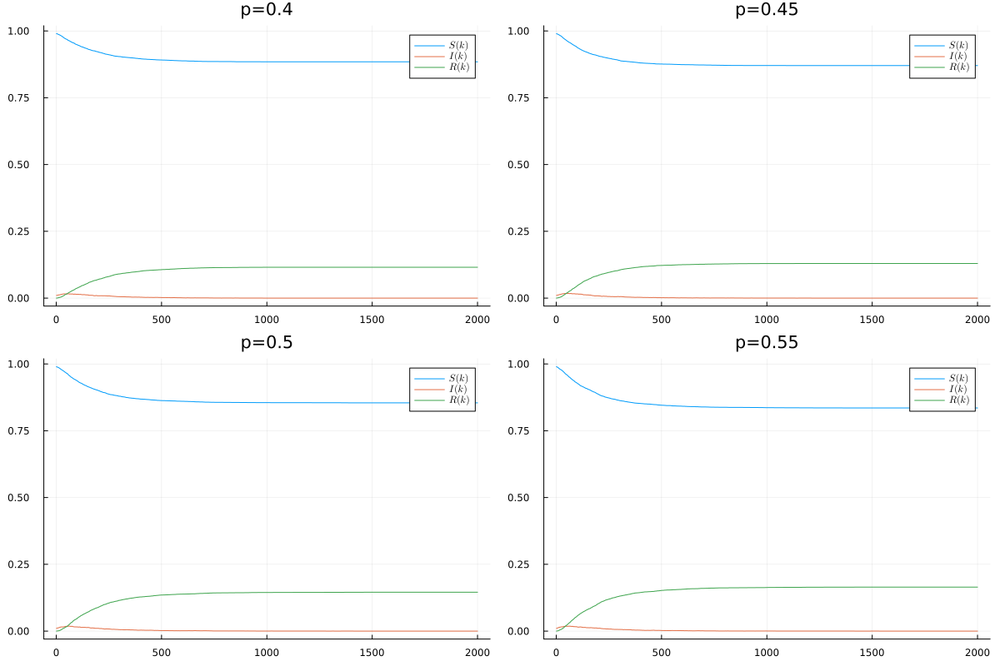

In [36]:
G4 = barabasi_albert(N , 2)

S1 , I1 , R1 = Infection_sim_asynchronous(G4 , p1 , nit , nsim)
S2 , I2 , R2 = Infection_sim_asynchronous(G4 , p2 , nit , nsim)
S3 , I3 , R3 = Infection_sim_asynchronous(G4 , p3 , nit , nsim)
S4 , I4 , R4 = Infection_sim_asynchronous(G4 , p4 , nit , nsim)

plot1 = plot(S1 / N , label = L"S(k)" , title = "p=$(p1)")
plot!(I1 / N , label = L"I(k)")
plot!(R1 / N , label = L"R(k)")

plot2 = plot(S2 / N , label = L"S(k)" , title = "p=$(p2)")
plot!(I2 / N , label = L"I(k)")
plot!(R2 / N , label = L"R(k)")

plot3 = plot(S3 / N , label = L"S(k)" , title = "p=$(p3)")
plot!(I3 / N , label = L"I(k)")
plot!(R3 / N , label = L"R(k)")

plot4 = plot(S4 / N , label = L"S(k)" , title = "p=$(p4)")
plot!(I4 / N , label = L"I(k)")
plot!(R4 / N , label = L"R(k)")

plot(plot1 , plot2 , plot3 , plot4 , size = (1200 , 800) )